In [ ]:

import umap
import matplotlib.pyplot as plt
import matplotlib as mpl
from sklearn.metrics import adjusted_rand_score as ARI
from sklearn.metrics import adjusted_mutual_info_score as AMI

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
rcParams['figure.figsize'] = (12,12)


sc.settings.verbosity =0

import matplotlib.pyplot as plt
import pandas as pd
import scanpy as sc



/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/marioam/miniconda3/envs/General_env/lib/python3.9/si

In [2]:
save_key='RNA_STWG'

# WE LOAD LABELS TRANSFERED from HCA and INTEGRATED LATENT SPACES 
## Then we perform CLUSTERING

In [ ]:
latents = ['Harmony','Unintegrated','scVI','Scanorama']
compute = True
if compute:
    adata = sc.read(f'objects/{save_key}.h5ad')
    for i in latents:
        print(i)
        l = pd.read_csv(f'csv/{mod}_{i}.csv', index_col=0)
        l = l.loc[adata.obs.index]
        adata.obsm[i] = l.values
        sc.pp.neighbors(adata, use_rep=i, n_neighbors=50)
        sc.tl.umap(adata)
        adata.obsm[f'Umap_{i}'] = adata.obsm['X_umap']
    adata.write(f'objects/byTech/{mod}_final.h5ad', compression='gzip')
else:
    adata = sc.read(f'objects/byTech/{mod}_final.h5ad')

In [ ]:
adata.obs['Deepscore_HCA_l1_Clean'] = ''
for mod in ['snRNA','scRNA5p','scRNA']:
    batch_mask = adata.obs['Technology'] == dict_tech[mod]

    ds = pd.read_csv(f'../DEEPSCORE/csv/Deepscore_HCA_l1_{mod}_CLEAN.csv',index_col=0)
    adata.obs.loc[adata[batch_mask].obs.index, ['Deepscore_HCA_l1_Clean']]  = ds['Deepscore_HCA']
    adata.obs.loc[adata[batch_mask].obs.index, ['Deepscore_HCA_l1_Clean_score']]  = ds['Deepscore_HCA_score']
        

adata.obs['Deepscore_HCA_l3_Clean'] = adata.obs['Deepscore_HCA_l1_Clean'].tolist()
adata.obs['Deepscore_HCA_l3_Clean_score'] = adata.obs['Deepscore_HCA_l1_Clean_score'].tolist()

for mod in ['snRNA','scRNA5p','scRNA']:
    batch_mask = adata.obs['Technology'] == dict_tech[mod]
    for ct in ['IMM', 'DCT', 'PT', 'CNT', 'TAL', 'IC', 'EC', 'FIB', 'PC', 'VSM/P']:
        c = ct.replace('/','_')
        try:
            ds = pd.read_csv(f'../DEEPSCORE/csv/Deepscore_HCA_l3_{mod}_{c}_CLEAN.csv',index_col=0)
            ct_mask = (adata.obs['Deepscore_HCA_l1_Clean'] == ct) & batch_mask
            print(sum(ct_mask))
            adata.obs.loc[adata[ct_mask].obs.index, ['Deepscore_HCA_l3_Clean']] = ds['Deepscore_HCA']
            adata.obs.loc[adata[ct_mask].obs.index, ['Deepscore_HCA_l3_Clean_score']] = ds['Deepscore_HCA_score']
        except:
            print(f'{mod} {ct} dont have substates')

adata.write(f'objects/byTech/{mod}_final.h5ad', compression='gzip') # UPDATE THE OBJECT

In [3]:
adata = sc.read('objects/RNA_STWG_final.h5ad')
adata

AnnData object with n_obs × n_vars = 97125 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external', 'Doublet_Detection_doublets_scRNA', 'Doublet_Detection_doublets_score_scRNA', 'Doublet_Detection_doublets_scRNA5p', 'Doublet_Detection_doublets_score_scRNA5p', 'AMULET_doublets', 'AMULET_pval', 'AMULET_qval', 'Doublet_Detection_doublets_snRNA', 'Doublet_Detection_doublets_score_snRNA', 'In_final_obj', 'Deepscore', 'Technology', 'Suspension_type', 'Study', 'Donor_id', 'Deepscore_HCA_l1_Clean', 'Deepscore_HCA_l1_full', 'Deepscore_HCA_l1_Clean_score', 'Deepscore_HCA_l1_Full', 'Deepscore_HCA_l1_Full_score', 'Deepscore_HCA_l3_Clean', 'Deepscore_HCA_l3_Clean_score', 'Deepscore_HCA_l3_Full', 'Deepscore_HCA_l3_Full_score', 'Deepscore_Muto', 'Deepscore_Muto_score', 'leiden_scVI_0.3', 'leiden_scVI_1.4', 'leiden_scVI_2', 'leiden_scVI_6', 'Manual_Annotation', 'Manual_Annotation_l

## AFTER a RUNNING the BENCHMARKIN pipeline WE SELECT scVI as the best performing tool
### We will compute cluster on different levels of resolution, seeking for those resolution that fit the best with the LABELS TRANSFERED 

## For the CHOOSEN RESOLUTION WE INSPECT CLUSTER MARKERS
# FINALLY ANNOTATE on the 2 RESOLUTION LEVELS by combining LT and Cluster Markers

In [4]:
adata

AnnData object with n_obs × n_vars = 97125 × 38224
    obs: 'sample', 'batch', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Deepscore_external', 'Doublet_Detection_doublets_scRNA', 'Doublet_Detection_doublets_score_scRNA', 'Doublet_Detection_doublets_scRNA5p', 'Doublet_Detection_doublets_score_scRNA5p', 'AMULET_doublets', 'AMULET_pval', 'AMULET_qval', 'Doublet_Detection_doublets_snRNA', 'Doublet_Detection_doublets_score_snRNA', 'In_final_obj', 'Deepscore', 'Technology', 'Suspension_type', 'Study', 'Donor_id', 'Deepscore_HCA_l1_Clean', 'Deepscore_HCA_l1_full', 'Deepscore_HCA_l1_Clean_score', 'Deepscore_HCA_l1_Full', 'Deepscore_HCA_l1_Full_score', 'Deepscore_HCA_l3_Clean', 'Deepscore_HCA_l3_Clean_score', 'Deepscore_HCA_l3_Full', 'Deepscore_HCA_l3_Full_score', 'Deepscore_Muto', 'Deepscore_Muto_score', 'leiden_scVI_0.3', 'leiden_scVI_1.4', 'leiden_scVI_2', 'leiden_scVI_6', 'Manual_Annotation', 'Manual_Annotation_l

In [5]:
adata.X = adata.layers['counts'].copy()
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
# sc.pp.scale(adata)
adata.layers['lognorm'] = adata.X.copy()

/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


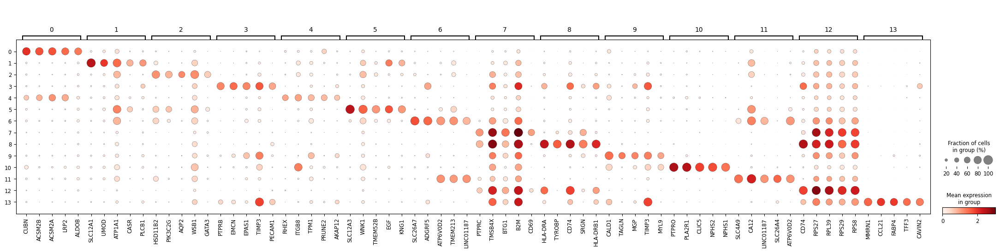

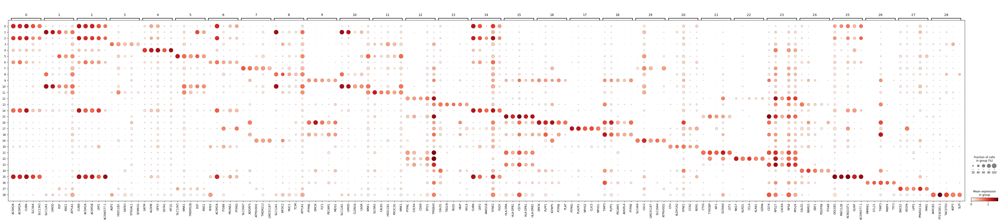

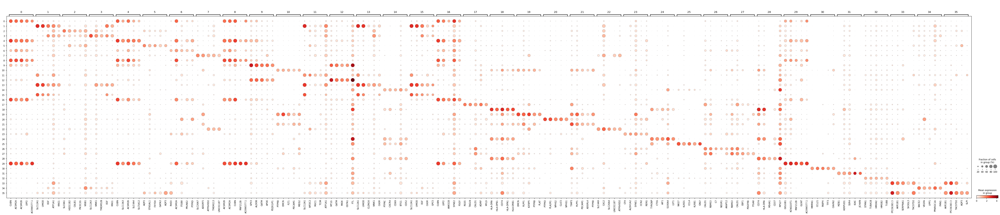

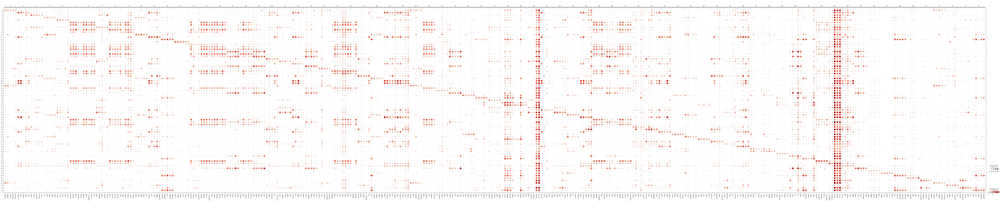

In [6]:
leiden_list = [f'leiden_scVI_0.3',f'leiden_scVI_1.4',f'leiden_scVI_2',f'leiden_scVI_6']

for leiden in leiden_list:

    markers_df = pd.read_csv(f'csv/clustering/AcrossTechs/{leiden}.csv', index_col=0)
    groupby=leiden

    top_genes = {}
    num_top_genes = 5  # number of top genes per cluster, adjust as needed

    for i in range(int(markers_df.shape[1] / 4)):  # assuming 4 columns per cluster
        cluster_genes = markers_df[f'{i}_n'].head(num_top_genes).tolist()
        top_genes[str(i)] = cluster_genes
    # Load or prepare your AnnData object
    # adata = sc.read_h5ad('your_adata_file.h5ad')  # replace with your AnnData file

    # Make sure adata has the groupby metadata, for example, 'treatment'
    # adata.obs['treatment'] should exist

    # Step 4: Plot using scanpy.pl.dotplot
    sc.pl.dotplot(adata, var_names=top_genes, groupby = leiden, var_group_labels = top_genes.keys, layer='lognorm', show=False)
    plt.savefig(f'figures/clusters/AcrossTechs/dotplot/{leiden}.png', dpi=300,bbox_inches='tight')
    

/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: Us

[<Axes: title={'center': 'leiden_scVI_0.3'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_1.4'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_2'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_6'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_10'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>]

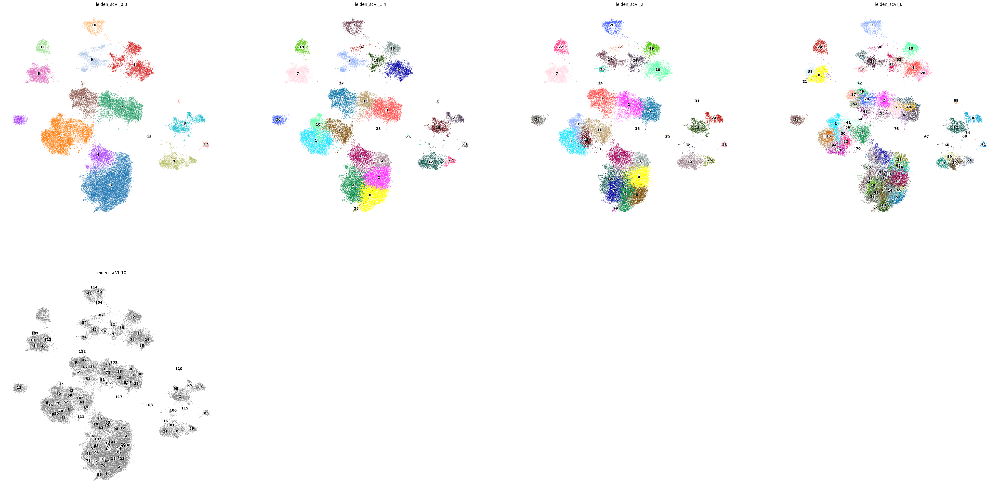

In [7]:
i = 'scVI'
plot_list = []
for k in [0.3,1.4,2,6,10]:
    plot_list.append(f'leiden_scVI_{k}')
sc.pl.embedding(adata, basis = f'Umap_{i}', color = plot_list, frameon = False, size = 3, legend_loc='on data', show=False, legend_fontoutline=2)


In [8]:
adata.obs['Manual_Annotation_l1'] = ''
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['2'])].obs.index,'Manual_Annotation_l1'] = 'CNT'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['0','4'])].obs.index,'Manual_Annotation_l1'] = 'PT'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['1'])].obs.index,'Manual_Annotation_l1'] = 'TAL'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['7','12','8'])].obs.index,'Manual_Annotation_l1'] = 'IMM'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['5'])].obs.index,'Manual_Annotation_l1'] = 'DCT'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['11','6'])].obs.index,'Manual_Annotation_l1'] = 'IC'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['10'])].obs.index,'Manual_Annotation_l1'] = 'POD'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['3'])].obs.index,'Manual_Annotation_l1'] = 'EC'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['13'])].obs.index,'Manual_Annotation_l1'] = 'EC'
adata.obs.loc[adata[adata.obs['leiden_scVI_0.3'].isin(['9'])].obs.index,'Manual_Annotation_l1'] = 'VSM/P'
adata.obs.loc[adata[adata.obs['leiden_scVI_2'].isin(['26'])].obs.index,'Manual_Annotation_l1'] = 'FIB'
adata.obs.loc[adata[adata.obs['leiden_scVI_1.4'].isin(['20'])].obs.index,'Manual_Annotation_l1'] = 'PEC'
adata.obs.loc[adata[adata.obs['leiden_scVI_2'].isin(['2'])].obs.index,'Manual_Annotation_l1'] = 'CNT'
adata.obs.loc[adata[adata.obs['leiden_scVI_2'].isin(['5'])].obs.index,'Manual_Annotation_l1'] = 'PC'


/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


[<Axes: title={'center': 'leiden_scVI_1.4'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_2'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_6'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_10'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>]

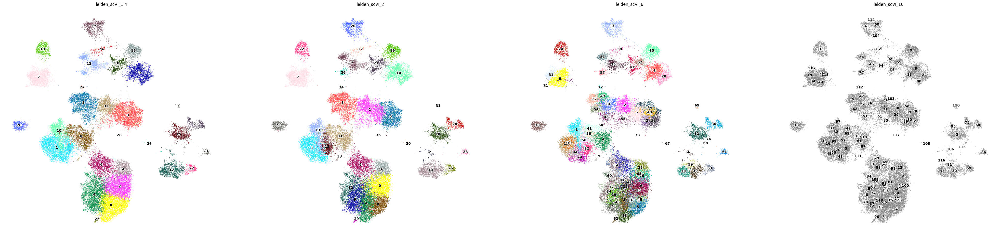

In [11]:
i = 'scVI'
plot_list = []
for k in [1.4,2,6,10]:
    plot_list.append(f'leiden_scVI_{k}')
sc.pl.embedding(adata, basis = f'Umap_{i}', color = plot_list, frameon = False, size = 3, legend_loc='on data', show=False, legend_fontoutline=2)


In [12]:
counts = adata.obs.groupby('Deepscore_HCA_l3_Clean')['leiden_scVI_2'].value_counts()

# Step 2: Unstack to create a DataFrame
percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))

# Step 2: Unstack to create a DataFrame
percentages_df = percentages.unstack(fill_value=0).T
most_abundant = percentages_df.apply(lambda x: pd.Series([x.max(), x.idxmax()], index=['Max_Percentage', 'Most_Abundant_Cell_Type']), axis=1)

# Step 2: Set the Leiden clusters as the index
most_abundant.index.name = 'Leiden_Cluster'
most_abundant.reset_index(inplace=True)
# most_abundant = most_abundant[~most_abundant['Most_Abundant_Cell_Type'].isin(present_ct)]
# most_abundant = most_abundant[most_abundant['Max_Percentage'] > 60]
most_abundant

/tmp/ipykernel_3473/3832350289.py:4: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))


,Leiden_Cluster,Max_Percentage,Most_Abundant_Cell_Type
0,0,46.901031,PT-S1/2
1,1,96.624266,C-TAL
2,2,46.112510,CNT
3,3,83.961944,DCT1
4,4,74.868220,PT-S1/2
5,5,82.071563,PC
6,6,87.337727,aPT
7,7,94.912878,CCD-IC-A
8,8,66.695919,PT-S1/2
9,9,57.552370,aPT


In [13]:
adata.obs['Manual_Annotation_l2'] =''

In [14]:
for i in range(36):
    adata.obs.loc[adata[adata.obs['leiden_scVI_2'].isin([str(i)])].obs.index,'Manual_Annotation_l2'] = most_abundant.iloc[i]['Most_Abundant_Cell_Type']

In [15]:
present_ct = adata.obs['Manual_Annotation_l2'].unique()

/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


[<Axes: title={'center': 'Manual_Annotation_l2'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'Deepscore_HCA_l3_Clean'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'Deepscore_HCA_l3_Full'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>]

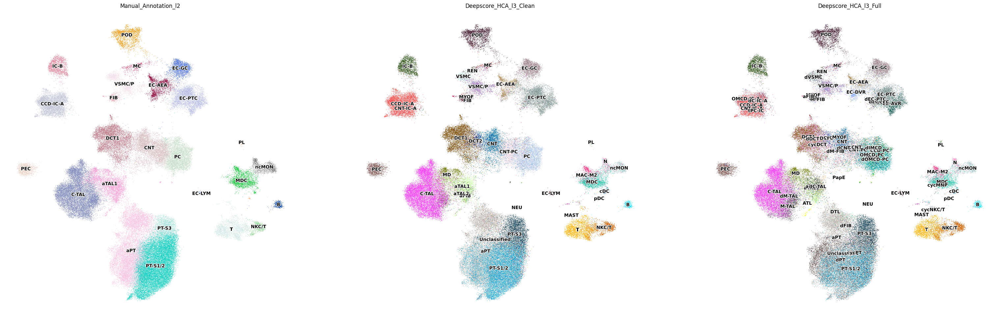

In [16]:
i = 'scVI'
plot_list = ['Manual_Annotation_l2','Deepscore_HCA_l3_Clean', 'Deepscore_HCA_l3_Full']
sc.pl.embedding(adata, basis = f'Umap_{i}', color = plot_list, frameon = False, size = 3, legend_loc='on data', show=False, legend_fontoutline=2)


In [17]:
adata.obs['Manual_Annotation_l2'] = adata.obs['Manual_Annotation_l2'].tolist()
adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['25','26'])].obs.index,'Manual_Annotation_l2'] = 'PT-S3'

adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['7'])].obs.index,'Manual_Annotation_l2'] = 'CNT-PC'
adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['12'])].obs.index,'Manual_Annotation_l2'] = 'MDC'
adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['35'])].obs.index,'Manual_Annotation_l2'] = 'VSMC/P'
adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['41'])].obs.index,'Manual_Annotation_l2'] = 'MD'
adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['51'])].obs.index,'Manual_Annotation_l2'] = 'VSMC'
adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['61'])].obs.index,'Manual_Annotation_l2'] = 'B'
adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['67'])].obs.index,'Manual_Annotation_l2'] = 'EC-LYM'
adata.obs.loc[adata[adata.obs['leiden_scVI_6'].isin(['69'])].obs.index,'Manual_Annotation_l2'] = 'PL'

In [18]:
present_ct = adata.obs['Manual_Annotation_l2'].unique()

In [19]:
counts = adata.obs.groupby('Deepscore_HCA_l3_Clean')['leiden_scVI_10'].value_counts()

# Step 2: Unstack to create a DataFrame
percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))

# Step 2: Unstack to create a DataFrame
percentages_df = percentages.unstack(fill_value=0).T
most_abundant = percentages_df.apply(lambda x: pd.Series([x.max(), x.idxmax()], index=['Max_Percentage', 'Most_Abundant_Cell_Type']), axis=1)

# Step 2: Set the Leiden clusters as the index
most_abundant.index.name = 'Leiden_Cluster'
most_abundant.reset_index(inplace=True)
most_abundant = most_abundant[~most_abundant['Most_Abundant_Cell_Type'].isin(present_ct)]
most_abundant = most_abundant[most_abundant['Max_Percentage'] > 60]
most_abundant

/tmp/ipykernel_3473/3314517753.py:4: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))


,Leiden_Cluster,Max_Percentage,Most_Abundant_Cell_Type
95,95,87.331536,MAC-M2
115,115,72.222222,pDC
116,116,100.000000,MAST


In [20]:
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['64'])].obs.index,'Manual_Annotation_l2'] = 'ncMON'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['95'])].obs.index,'Manual_Annotation_l2'] = 'MAC-M2'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['115'])].obs.index,'Manual_Annotation_l2'] = 'pDC'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['116'])].obs.index,'Manual_Annotation_l2'] = 'MAST'

In [21]:
present_ct = adata.obs['Manual_Annotation_l2'].unique()

In [22]:
counts = adata.obs.groupby('Deepscore_HCA_l3_Full')['leiden_scVI_10'].value_counts()

# Step 2: Unstack to create a DataFrame
percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))

# Step 2: Unstack to create a DataFrame
percentages_df = percentages.unstack(fill_value=0).T
most_abundant = percentages_df.apply(lambda x: pd.Series([x.max(), x.idxmax()], index=['Max_Percentage', 'Most_Abundant_Cell_Type']), axis=1)

# Step 2: Set the Leiden clusters as the index
most_abundant.index.name = 'Leiden_Cluster'
most_abundant.reset_index(inplace=True)
most_abundant = most_abundant[~most_abundant['Most_Abundant_Cell_Type'].isin(present_ct)]
# most_abundant = most_abundant[most_abundant['Max_Percentage'] > 45]
# Step 3: Plotting the heatmap
# plt.figure(figsize=(24,20))
# sns.heatmap(percentages_df, annot=True, cmap='viridis', fmt='.2f')
# plt.title('Heatmap of subclass.l1 Counts in Each Tissue')
# plt.ylabel('Tissue')
# plt.xlabel('Subclass.l3')
# plt.savefig('hm_leiden_1.4.png')
# plt.show()
most_abundant

/tmp/ipykernel_3473/3374018887.py:4: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))


,Leiden_Cluster,Max_Percentage,Most_Abundant_Cell_Type
1,1,53.407105,Unclassified
5,5,26.654298,M-TAL
7,7,59.680511,Unclassified
18,18,39.173680,aTAL2
22,22,71.394231,dOMCD-PC
24,24,46.786005,EC-AVR
36,36,27.052239,dDCT
39,39,26.845638,dOMCD-PC
46,46,35.794872,Unclassified
48,48,50.321888,dPT


/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


[<Axes: title={'center': 'leiden_scVI_1.4'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_2'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_6'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'leiden_scVI_10'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>]

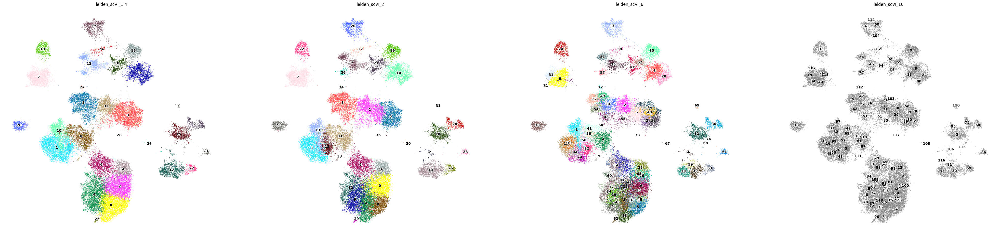

In [23]:
i = 'scVI'
plot_list = []
for k in [1.4,2,6,10]:
    plot_list.append(f'leiden_scVI_{k}')
sc.pl.embedding(adata, basis = f'Umap_{i}', color = plot_list, frameon = False, size = 3, legend_loc='on data', show=False, legend_fontoutline=2)


In [ ]:
counts = adata.obs.groupby('Deepscore_HCA_l3_Full')['leiden_scVI_6'].value_counts()

# Step 2: Unstack to create a DataFrame
percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))

# Step 2: Unstack to create a DataFrame
percentages_df = percentages.unstack(fill_value=0).T
most_abundant = percentages_df.apply(lambda x: pd.Series([x.max(), x.idxmax()], index=['Max_Percentage', 'Most_Abundant_Cell_Type']), axis=1)

# Step 2: Set the Leiden clusters as the index
most_abundant.index.name = 'Leiden_Cluster'
most_abundant.reset_index(inplace=True)
most_abundant = most_abundant[~most_abundant['Most_Abundant_Cell_Type'].isin(present_ct)]


/tmp/ipykernel_3473/1120729217.py:4: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))


In [25]:
percentages_df.loc['29','M-TAL']

34.996801023672425

In [26]:
percentages_df.loc['29','C-TAL']

44.785668586052466

In [ ]:
counts = adata.obs.groupby('Deepscore_HCA_l3_Full')['leiden_scVI_1.4'].value_counts()

# Step 2: Unstack to create a DataFrame
percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))

# Step 2: Unstack to create a DataFrame
percentages_df = percentages.unstack(fill_value=0).T
most_abundant = percentages_df.apply(lambda x: pd.Series([x.max(), x.idxmax()], index=['Max_Percentage', 'Most_Abundant_Cell_Type']), axis=1)

# Step 2: Set the Leiden clusters as the index
most_abundant.index.name = 'Leiden_Cluster'
most_abundant.reset_index(inplace=True)
most_abundant = most_abundant[~most_abundant['Most_Abundant_Cell_Type'].isin(present_ct)]


/tmp/ipykernel_3473/969366937.py:4: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))


In [28]:
percentages_df.loc['4','PT-S1/2']

23.418910457107074

In [29]:
percentages_df.loc['4','aPT']

25.46023794614903

In [30]:
percentages_df.loc['4','dPT']

33.888541014402

In [ ]:
counts = adata.obs.groupby('Deepscore_HCA_l3_Full')['leiden_scVI_2'].value_counts()

# Step 2: Unstack to create a DataFrame
percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))

# Step 2: Unstack to create a DataFrame
percentages_df = percentages.unstack(fill_value=0).T
most_abundant = percentages_df.apply(lambda x: pd.Series([x.max(), x.idxmax()], index=['Max_Percentage', 'Most_Abundant_Cell_Type']), axis=1)

# Step 2: Set the Leiden clusters as the index
most_abundant.index.name = 'Leiden_Cluster'
most_abundant.reset_index(inplace=True)
most_abundant = most_abundant[~most_abundant['Most_Abundant_Cell_Type'].isin(present_ct)]


/tmp/ipykernel_3473/1233775207.py:4: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  percentages = counts.groupby(level=1).apply(lambda x: 100 * x / float(x.sum()))


In [32]:
percentages_df.loc['9','PT-S1/2']

38.80926130099228

In [33]:
percentages_df.loc['9','aPT']

25.77728776185226

In [34]:
percentages_df.loc['12','PT-S1/2']

4.700615556799105

In [35]:
percentages_df.loc['12','aPT']

24.622271964185785

In [36]:
percentages_df.loc['6','aPT']

84.06231276213302

In [37]:
adata.obs['Manual_Annotation_l2'] = adata.obs['Manual_Annotation_l2'].tolist()
adata.obs.loc[adata[adata.obs['leiden_scVI_2'].isin(['9'])].obs.index,'Manual_Annotation_l2'] = 'PT-S1/2'
adata.obs.loc[adata[adata.obs['leiden_scVI_2'].isin(['12'])].obs.index,'Manual_Annotation_l2'] = 'aPT'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['75'])].obs.index,'Manual_Annotation_l2'] = 'N'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['24'])].obs.index,'Manual_Annotation_l2'] = 'EC-AVR'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['74'])].obs.index,'Manual_Annotation_l2'] = 'EC-DVR'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['88'])].obs.index,'Manual_Annotation_l2'] = 'EC-AVR'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['111'])].obs.index,'Manual_Annotation_l2'] = 'ATL'
adata.obs.loc[adata[adata.obs['leiden_scVI_10'].isin(['107'])].obs.index,'Manual_Annotation_l2'] = 'OMCD-IC-A'

/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


[<Axes: title={'center': 'Manual_Annotation_l2'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'Deepscore_HCA_l3_Clean'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>,
 <Axes: title={'center': 'Deepscore_HCA_l3_Full'}, xlabel='Umap_scVI1', ylabel='Umap_scVI2'>]

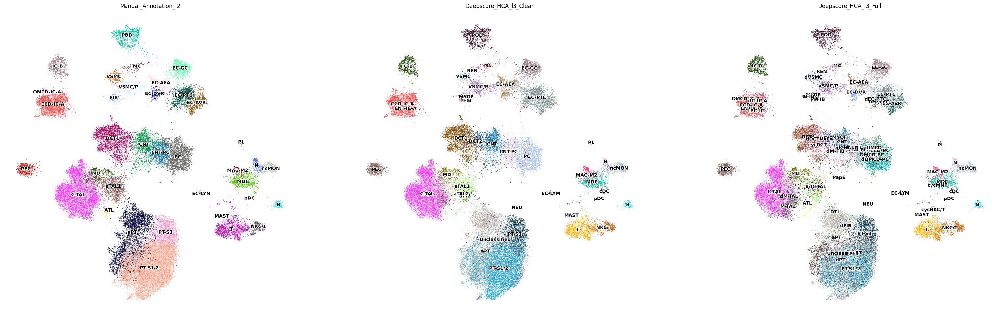

In [ ]:
i = 'scVI'
plot_list = ['Manual_Annotation_l2','Deepscore_HCA_l3_Clean', 'Deepscore_HCA_l3_Full']
sc.pl.embedding(adata, basis = f'Umap_{i}', color = plot_list, frameon = False, size = 3, legend_loc='on data', show=False, legend_fontoutline=2)

# FINAL MANUAL ANNOTATION

/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


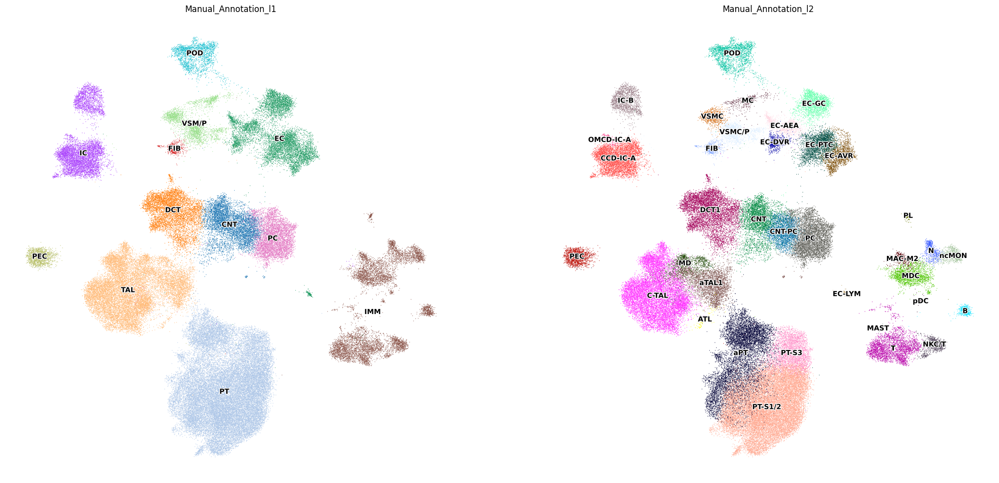

In [39]:
i = 'scVI'
plot_list = ['Manual_Annotation_l1','Manual_Annotation_l2']
sc.pl.embedding(adata, basis = f'Umap_{i}', color = plot_list, frameon = False, size = 3, legend_loc='on data', show=False, legend_fontoutline=2)
plt.savefig('figures/AcrossTechs/scVI_Manual_Ann.png',  dpi=300,bbox_inches='tight')

In [40]:
adata.obs.to_csv('csv/clustering/AcrossTechs/Manual_Ann.csv')

/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marioam/miniconda3/envs/General_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


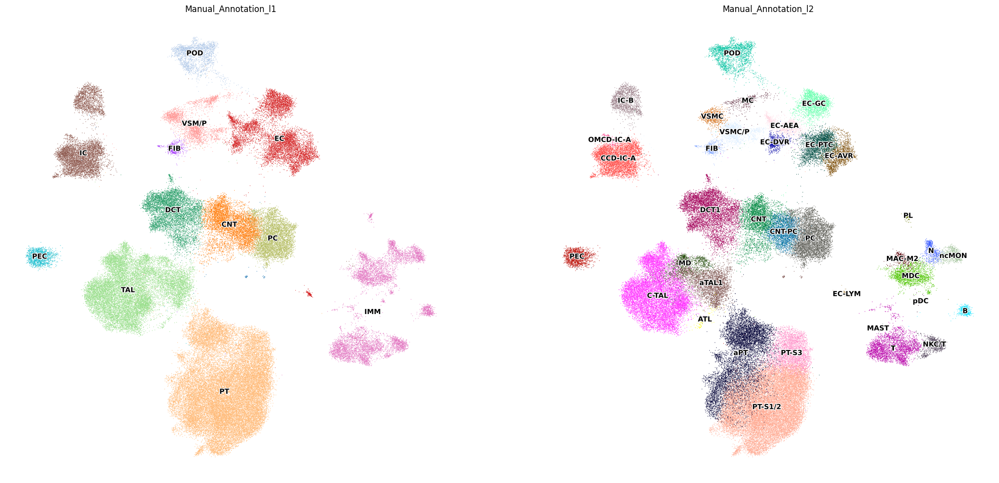

In [64]:
i = 'scVI'
plot_list = ['Manual_Annotation_l1','Manual_Annotation_l2']
sc.pl.embedding(adata, basis = f'Umap_{i}', color = plot_list, frameon = False, size = 3, legend_loc='on data', show=False, legend_fontoutline=2)
plt.savefig('figures/AcrossTechs/scVI_Manual_Ann.png',  dpi=300,bbox_inches='tight')

In [ ]:
adata.obs.to_csv('csv/CLUSTERS_METADATA.csv')

In [66]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [ ]:
ann_list = ['Manual_Annotation_l1','Manual_Annotation_l2']
for ann in ann_list:
    sc.tl.rank_genes_groups(adata, groupby=ann, method='wilcoxon')
    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','pvals_adj', 'logfoldchanges']}).to_csv(f'csv/clustering/AcrossTechs/{ann}.csv')